# Análisis de Datos de Viajes en Bicicletas Públicas en la Ciudad de Buenos Aires

En este informe, se presenta un análisis detallado de los datos de viajes en bicicletas públicas en la Ciudad de Buenos Aires. El objetivo principal es modelar los viajes como una red y proporcionar visualizaciones intuitivas para entender las características clave de los datos.

In [2]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns

## Exploración de datos

Primero, cargo los datos desde el archivo CSV proporcionado. El conjunto de datos contiene información sobre los recorridos de bicicletas públicas, incluyendo la duración del recorrido, ubicación de estaciones, fecha y hora, entre otros.

In [3]:
df = pd.read_csv('trips_2023.csv', parse_dates=['fecha_origen_recorrido', 'fecha_destino_recorrido'])

df.head()

,Unnamed: 0,Id_recorrido,duracion_recorrido,fecha_origen_recorrido,id_estacion_origen,nombre_estacion_origen,direccion_estacion_origen,long_estacion_origen,lat_estacion_origen,fecha_destino_recorrido,id_estacion_destino,nombre_estacion_destino,direccion_estacion_destino,long_estacion_destino,lat_estacion_destino,id_usuario,modelo_bicicleta,género
0,1,17910696BAEcobici,"1,848",2023-04-24 10:30:10,358BAEcobici,249 - Balbín,2519 Conesa,-58.465586,-34.561486,2023-04-24 11:00:58,278BAEcobici,233 - MONROE,2519 Superi,-58.469813,-34.564122,861866BAEcobici,ICONIC,MALE
1,2,17600256BAEcobici,288,2023-03-22 17:40:55,444BAEcobici,061 - Ministerio de Economia,"Balcarce e Yrigoyen, Hipolito Av.",-58.370716,-34.608936,2023-03-22 17:45:43,3BAEcobici,003 - ADUANA,Moreno & Azopardo,-58.368174,-34.611102,217525BAEcobici,ICONIC,FEMALE
2,3,17255670BAEcobici,"1,103",2023-02-15 23:12:22,280BAEcobici,222 - SIMON BOLIVAR,"1701 Fernandez Moreno, Baldomero",-58.449379,-34.633528,2023-02-15 23:30:45,280BAEcobici,222 - SIMON BOLIVAR,"1701 Fernandez Moreno, Baldomero",-58.449379,-34.633528,954201BAEcobici,ICONIC,MALE
3,4,17996972BAEcobici,"1,165",2023-05-03 11:00:20,273BAEcobici,223 - GAINZA,"494 Gainza, Martin De, Gral.",-58.446751,-34.616758,2023-05-03 11:19:45,367BAEcobici,287 - Belaustegui,"Belaustegui, Luis, Dr. 2890",-58.477209,-34.616212,179414BAEcobici,ICONIC,MALE
4,5,17148836BAEcobici,378,2023-02-06 06:50:58,65BAEcobici,065 - Julián Álvarez,3822 Guemes,-58.415787,-34.587312,2023-02-06 06:57:16,14BAEcobici,014 - Pacifico,"Santa Fe Av. & Bullrich, Int. Av.",-58.426387,-34.577424,8098BAEcobici,ICONIC,MALE


## Modelado de los viajes como una red

Utilizo la biblioteca `NetworkX` para modelar los viajes como un grafo dirigido. Cada estación de bicicletas se representa como un nodo, y las conexiones entre estaciones se definen como aristas ponderadas por la duración del recorrido.

In [26]:
# Limpiar los datos eliminando filas con valores no numéricos y filas con valores nan.
df = df[pd.to_numeric(df['duracion_recorrido'], errors='coerce').notnull()]
df = df.dropna(subset=['nombre_estacion_origen', 'nombre_estacion_destino', 'duracion_recorrido'])

G = nx.DiGraph()

for index, row in df.iterrows():
    G.add_edge(row['nombre_estacion_origen'], row['nombre_estacion_destino'], weight=row['duracion_recorrido'])

## Análisis de la red

In [27]:
num_nodos = len(G.nodes)
num_aristas = len(G.edges)
densidad_red = nx.density(G)


print(f'Número de nodos en la red: {num_nodos}')
print(f'Número de aristas en la red: {num_aristas}')
print(f'Densidad de la red: {densidad_red}')

Número de nodos en la red: 366
Número de aristas en la red: 24920
Densidad de la red: 0.186540908750655


### Centralidad de Nodos:

Calculo la centralidad de grado (importancia relativa de un nodo en función del número de conexiones quer tiene con otros) de los nodos para identificar estaciones clave en la red.
Las estaciones más centrales son aquellas que tienen más conexiones con otras estaciones, lo que podría indicar su importancia en términos de accesibilidad y conectividad en la red.

In [44]:
degree_centrality = nx.degree_centrality(G)

central_stations = sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:5]
print("Estaciones más centrales:", central_stations)

Estaciones más centrales: ['054 - Acuña de Figueroa', '131- HOSPITAL DE CLÍNICAS', '008 - Congreso', '033 - Facultad de Medicina', '162 - LARREA Y BARTOLOMÉ MITRE']


### Rutas más frecuentes:

Identifico las rutas más frecuentes en función de la cantidad de veces que son recorridas.

In [45]:
frecuencia_rutas = df.groupby(['nombre_estacion_origen', 'nombre_estacion_destino']).size().reset_index(name='frecuencia')

rutas_mas_frecuentes = frecuencia_rutas.sort_values(by='frecuencia', ascending=False).head(5)

print(rutas_mas_frecuentes[['nombre_estacion_origen', 'nombre_estacion_destino', 'frecuencia']])

         nombre_estacion_origen           nombre_estacion_destino  frecuencia
1241             014 - Pacifico  391 - Plaza República de Ecuador        2014
24660           393 - Barrio 31                   130 - RETIRO II        1950
10341           130 - RETIRO II               237 - Madero Office        1866
2224        026 - JUANA MANSO I                   130 - RETIRO II        1861
23002  352 - San Jose de Flores                     206 - Galicia        1803


### Cantidad de viajes según género
El gráfico muestra la distribución de género en los viajes en bicicleta pública en la Ciudad de Buenos Aires. Se observa una comparación entre la cantidad de viajes realizados por mujeres y hombres.

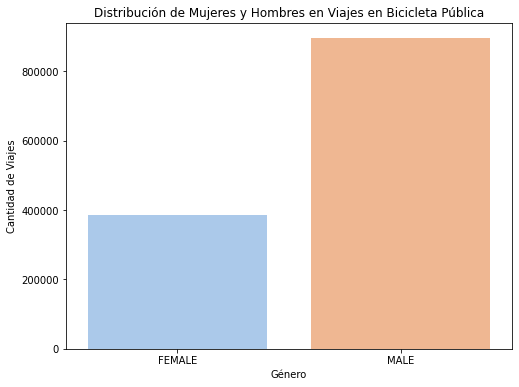

In [51]:
import matplotlib.pyplot as plt
import seaborn as sns

df_genero = df[df['género'].isin(['FEMALE', 'MALE'])]

plt.figure(figsize=(8, 6))
sns.countplot(x='género', data=df_genero, palette='pastel')
plt.title('Distribución de Mujeres y Hombres en Viajes en Bicicleta Pública')
plt.xlabel('Género')
plt.ylabel('Cantidad de Viajes')
plt.show()


## Análisis geoespacial

Usando el siguiente mapa de calor se pueden identificar las áreas de la ciudad con mayor actividad.

In [47]:
import folium
from folium.plugins import HeatMap

mapa_calor = folium.Map(location=[-34.61, -58.38], zoom_start=13)

HeatMap(df[['lat_estacion_origen', 'long_estacion_origen']].values).add_to(mapa_calor)

mapa_calor


## Análisis temporal

### Duración promedio de los viajes

In [28]:
duracion_promedio = df['duracion_recorrido'].mean()
print(f'Duración promedio de los viajes: {duracion_promedio} minutos')

Duración promedio de los viajes: 597.7491247043639 minutos


### Distribución de duración de los viajes

Esto proporciona una visión sobre cómo se distribuyen las duraciones de los recorridos en la red de bicicletas públicas.

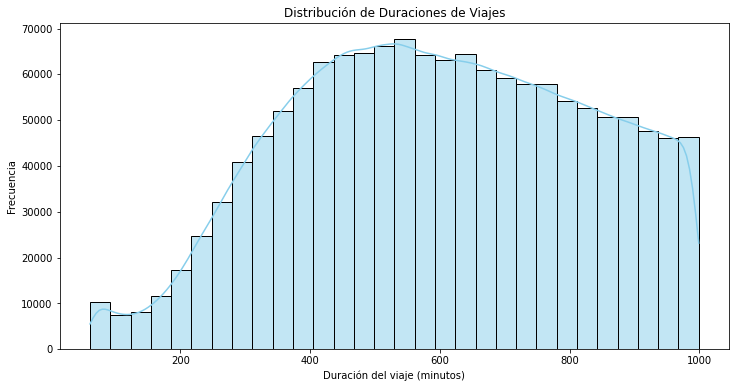

In [30]:
plt.figure(figsize=(12, 6))
sns.histplot(df['duracion_recorrido'].dropna(), bins=30, kde=True, color='skyblue')
plt.title('Distribución de Duraciones de Viajes')
plt.xlabel('Duración del viaje (minutos)')
plt.ylabel('Frecuencia')
plt.show()


### Cantidad de viajes por mes

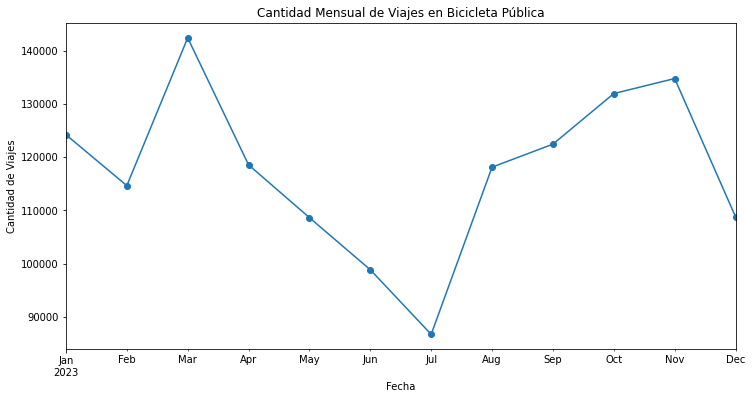

In [41]:
monthly_trips = df.resample('M', on='fecha_origen_recorrido').size()

plt.figure(figsize=(12, 6))
monthly_trips.plot(marker='o')
plt.title('Cantidad Mensual de Viajes en Bicicleta Pública')
plt.xlabel('Fecha')
plt.ylabel('Cantidad de Viajes')
plt.show()


### Horas pico: 
Identificar las horas del día con mayor y menor demanda de bicicletas públicas.

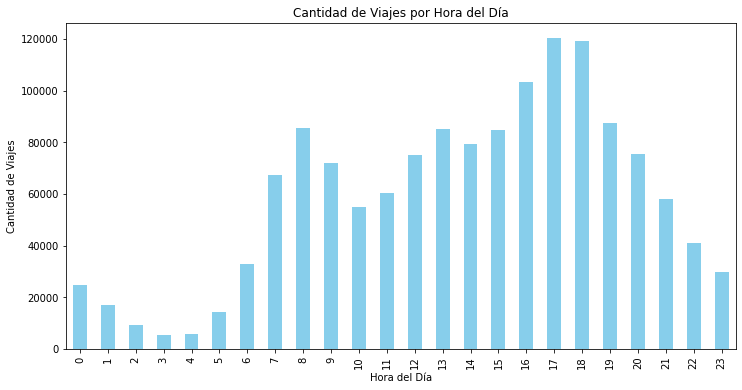

In [42]:
df['hora_del_dia'] = df['fecha_origen_recorrido'].dt.hour

hourly_trips = df['hora_del_dia'].value_counts().sort_index()

plt.figure(figsize=(12, 6))
hourly_trips.plot(kind='bar', color='skyblue')
plt.title('Cantidad de Viajes por Hora del Día')
plt.xlabel('Hora del Día')
plt.ylabel('Cantidad de Viajes')
plt.show()
